In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [2]:
!git clone https://github.com/VA0211/mri_timm.git

Cloning into 'mri_timm'...
remote: Enumerating objects: 849, done.
remote: Counting objects: 100% (849/849), done.
remote: Compressing objects: 100% (654/654), done.
remote: Total 849 (delta 183), reused 849 (delta 183), pack-reused 0 (from 0)
Receiving objects: 100% (849/849), 1.99 MiB | 11.04 MiB/s, done.
Resolving deltas: 100% (183/183), done.


In [3]:
# %pip install ultralytics
%cd /kaggle/working/mri_timm
%pip install -e .
import ultralytics
ultralytics.checks()

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [4]:
from ultralytics import YOLO

# Load a model
model = YOLO("/kaggle/working/mri_timm/ultralytics/cfg/models/11/11s-seresnet50-timm.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      device=0,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

WARNING ⚠️ no model scale passed. Assuming scale='s'.


model.safetensors:   0%|          | 0.00/113M [00:00<?, ?B/s]

New https://pypi.org/project/ultralytics/8.3.102 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/kaggle/working/mri_timm/ultralytics/cfg/models/11/11s-seresnet50-timm.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=F

100%|██████████| 755k/755k [00:00<00:00, 17.6MB/s]


Overriding model.yaml nc=80 with nc=3
WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1  26039024  ultralytics.nn.modules.block.Timm            ['seresnet50', True, True, 0, True]
  1                   0  1         0  ultralytics.nn.modules.conv.Index            [2]                           
  2                   0  1         0  ultralytics.nn.modules.conv.Index            [3]                           
  3                   0  1         0  ultralytics.nn.modules.conv.Index            [4]                           
  4                  -1  1   4197376  ultralytics.nn.modules.block.SPPF            [2048, 512, 5]                
  5                  -1  1    990976  ultralytics.nn.modules.block.C2PSA           [512, 512, 1]                 
  6                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest'] 

100%|██████████| 5.35M/5.35M [00:00<00:00, 66.5MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:03<00:00, 460.14it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 459.61it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.


Plotting labels to /kaggle/working/mri_timm/runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 103 weight(decay=0.0), 142 weight(decay=0.0005), 141 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /kaggle/working/mri_timm/runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      10.1G      3.089       5.67      3.839         14        640: 100%|██████████| 109/109 [01:24<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.19it/s]

                   all        217        163    0.00119      0.375    0.00759    0.00386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      12.6G       2.41       3.23      2.753         12        640: 100%|██████████| 109/109 [01:31<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.55it/s]

                   all        217        163       0.46      0.486      0.433       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      12.6G      2.131      2.292      2.434         12        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        163      0.701      0.542      0.665      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      12.6G      2.027      1.878      2.321          8        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        163      0.625      0.627      0.671      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      12.6G      1.927      1.586      2.217         22        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        163      0.783      0.632      0.742      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      12.6G      1.838      1.426      2.139         20        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.55it/s]

                   all        217        163      0.723       0.67      0.744      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      12.6G      1.806      1.367      2.087         16        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.55it/s]

                   all        217        163      0.644      0.704      0.721      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      12.6G      1.767      1.252      2.059         12        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.808      0.749      0.812      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      12.6G      1.764      1.237      2.074         16        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.55it/s]

                   all        217        163      0.814      0.769      0.821      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      12.6G      1.728      1.133      2.012         15        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163       0.72      0.642      0.747      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      12.6G      1.715      1.141      2.004         18        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.55it/s]

                   all        217        163       0.78       0.77      0.836      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      12.6G      1.681      1.074      1.984         21        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.791      0.774       0.82      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      12.6G      1.634      1.045      1.938         10        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        163      0.808      0.756      0.817      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      12.6G      1.641      1.004       1.92         15        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.856      0.837      0.875       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      12.6G      1.604     0.9785      1.889         20        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        163      0.769       0.82      0.835      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      12.6G      1.612     0.9618      1.892         14        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.786      0.806       0.84      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      12.6G      1.559     0.9255      1.858         14        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.836      0.667      0.775      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      12.6G      1.563     0.9081       1.86         12        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.855      0.804      0.874      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      12.6G      1.523     0.8922       1.82         15        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        163      0.853      0.789      0.881      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      12.6G       1.52     0.8753      1.822         11        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        163      0.861      0.776      0.846      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      12.6G      1.479     0.8276      1.776         15        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.919      0.791      0.902      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      12.6G      1.458     0.8079      1.754          7        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.804      0.726      0.802      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      12.6G       1.45      0.825      1.775         10        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.872      0.828      0.898      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      12.6G      1.419     0.8037      1.724         15        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.855      0.773      0.886      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      12.6G      1.421     0.7991      1.734         13        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.837      0.748       0.82      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      12.6G      1.376     0.7536      1.719         12        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.834      0.849      0.896      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      12.6G      1.396     0.8024      1.742         10        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.847      0.826      0.853      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      12.6G      1.342     0.7488      1.654         16        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.823      0.872      0.889      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      12.6G      1.341      0.747      1.671         17        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.808      0.849       0.87      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      12.6G      1.325     0.7524      1.639         11        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.844       0.81      0.857      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      12.6G       1.31     0.7315      1.647         12        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.849      0.823      0.885      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      12.6G      1.321     0.7228      1.635         14        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.879      0.891      0.926      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      12.6G      1.248     0.6712      1.569         16        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163       0.89      0.909      0.936      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      12.6G      1.269     0.6815      1.607         14        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.899      0.813      0.888      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      12.6G      1.269     0.6862      1.609         16        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163       0.83      0.849      0.892      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      12.6G      1.226     0.6741      1.583         16        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        163      0.919      0.835      0.911      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      12.6G      1.243     0.6666      1.556         15        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.859      0.829      0.877      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      12.6G      1.195     0.6597      1.552         21        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        163      0.851      0.845      0.904      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      12.6G      1.176     0.6508      1.535          8        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.832      0.898      0.885      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      12.6G      1.191     0.6544      1.521         16        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        163      0.837      0.855      0.892      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      12.6G      1.148     0.6213      1.498          6        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.864      0.852      0.902      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      12.6G      1.157     0.6152      1.517         15        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        163      0.919      0.846       0.93      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      12.6G      1.135     0.6197      1.485         16        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        163      0.906      0.864      0.911        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      12.6G      1.117     0.6093      1.464         18        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        163      0.896      0.855      0.924      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      12.6G      1.105     0.5917      1.474         14        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.855      0.836      0.902       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      12.6G      1.111     0.6009       1.47         13        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        163      0.923      0.805      0.907      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      12.6G      1.086     0.5971      1.463         17        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.851      0.875      0.899       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      12.6G      1.084     0.6115      1.441         13        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.851      0.862      0.898      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      12.6G      1.037     0.5712        1.4         11        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.859      0.863       0.92      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      12.6G      1.032     0.5567      1.404         20        640: 100%|██████████| 109/109 [01:29<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.891      0.834      0.929      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      12.6G      1.056     0.5807      1.433         13        640: 100%|██████████| 109/109 [01:29<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        163      0.882      0.883       0.91       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      12.6G      1.031     0.5671      1.408         19        640: 100%|██████████| 109/109 [01:30<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.58it/s]

                   all        217        163      0.881      0.866       0.91      0.479
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 42, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



52 epochs completed in 1.381 hours.
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/last.pt, 71.4MB
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/best.pt, 71.4MB

Validating /kaggle/working/mri_timm/runs/detect/train/weights/best.pt...
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11s-seresnet50-timm summary: 340 layers, 35,432,745 parameters, 0 gradients, 84.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.47it/s]


                   all        217        163      0.919      0.846      0.929      0.504
             pituitary         62         63      0.963      0.921       0.96      0.527
            meningioma         55         55      0.961      0.905      0.962      0.552
                glioma         45         45      0.833      0.711      0.866      0.434


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 17.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train


In [5]:
val_results = model.val(split='test')

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11s-seresnet50-timm summary: 340 layers, 35,432,745 parameters, 0 gradients, 84.0 GFLOPs


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:00<00:00, 384.97it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:09<00:00,  1.50it/s]


                   all        218        164      0.906      0.851       0.91      0.497
             pituitary         62         62      0.936      0.946      0.973      0.452
            meningioma         55         55      0.981      0.924      0.989      0.623
                glioma         46         47        0.8      0.683      0.768      0.416


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.5ms preprocess, 36.9ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train2


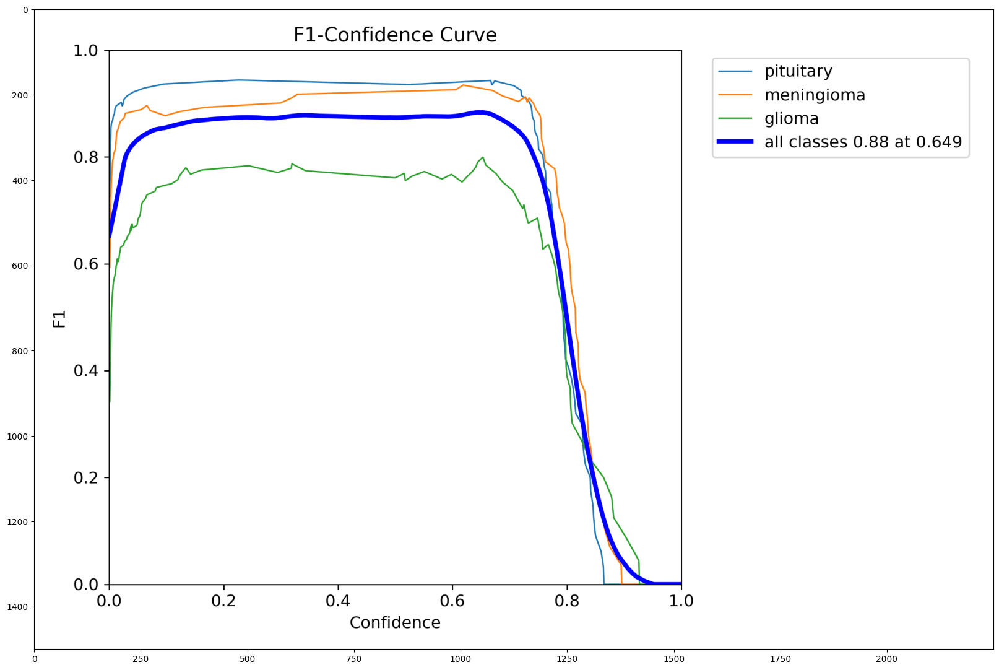

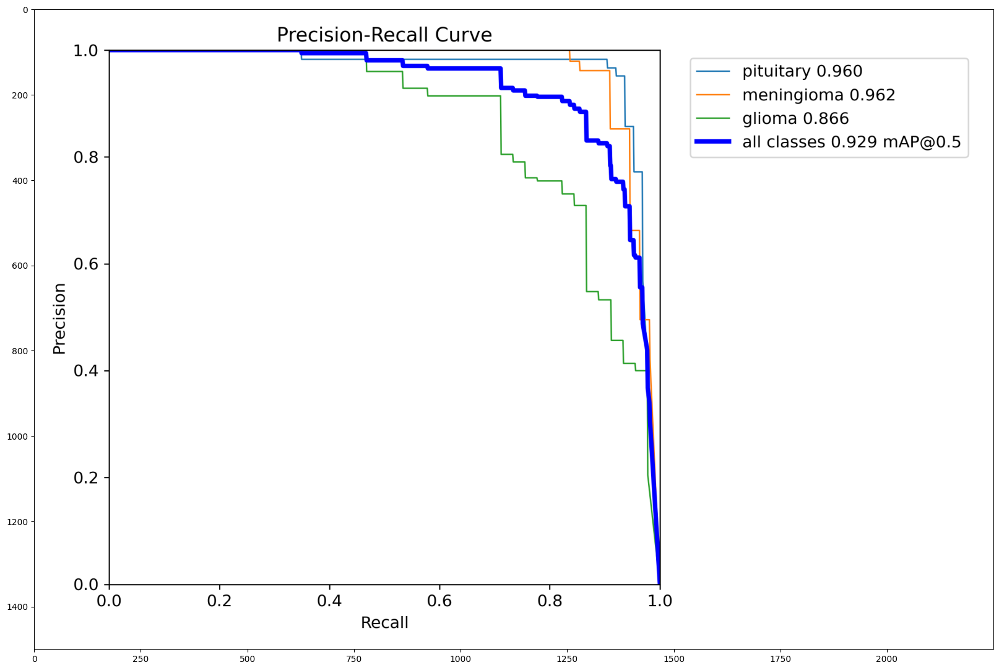

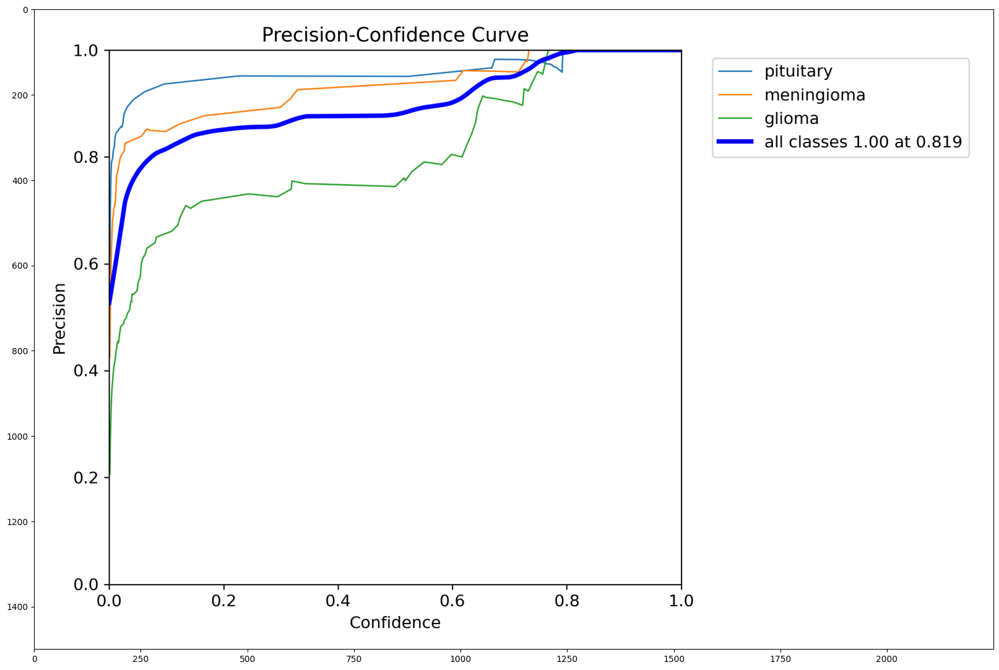

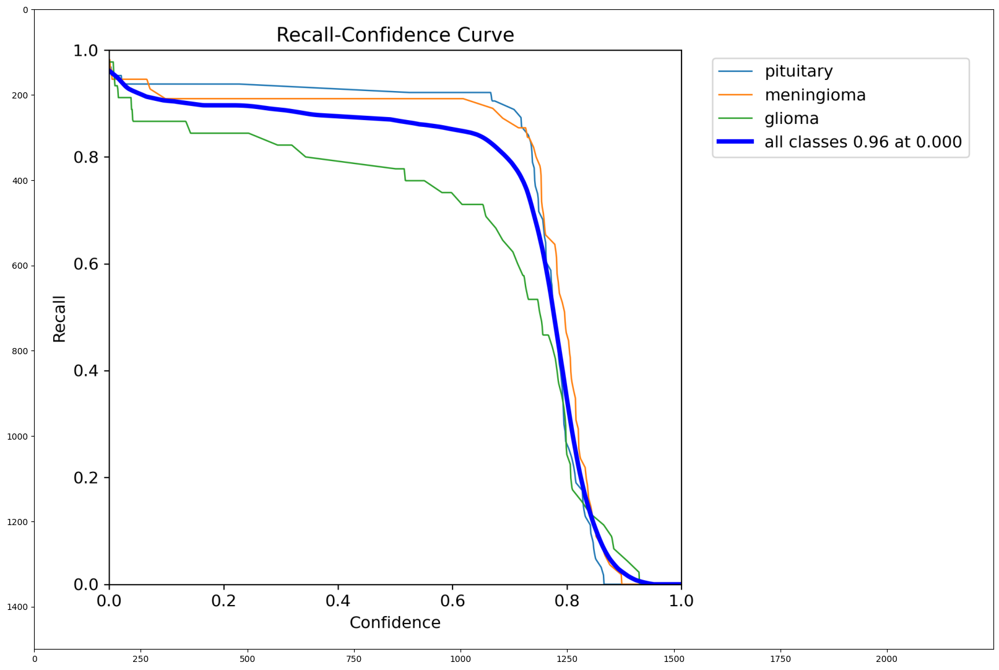

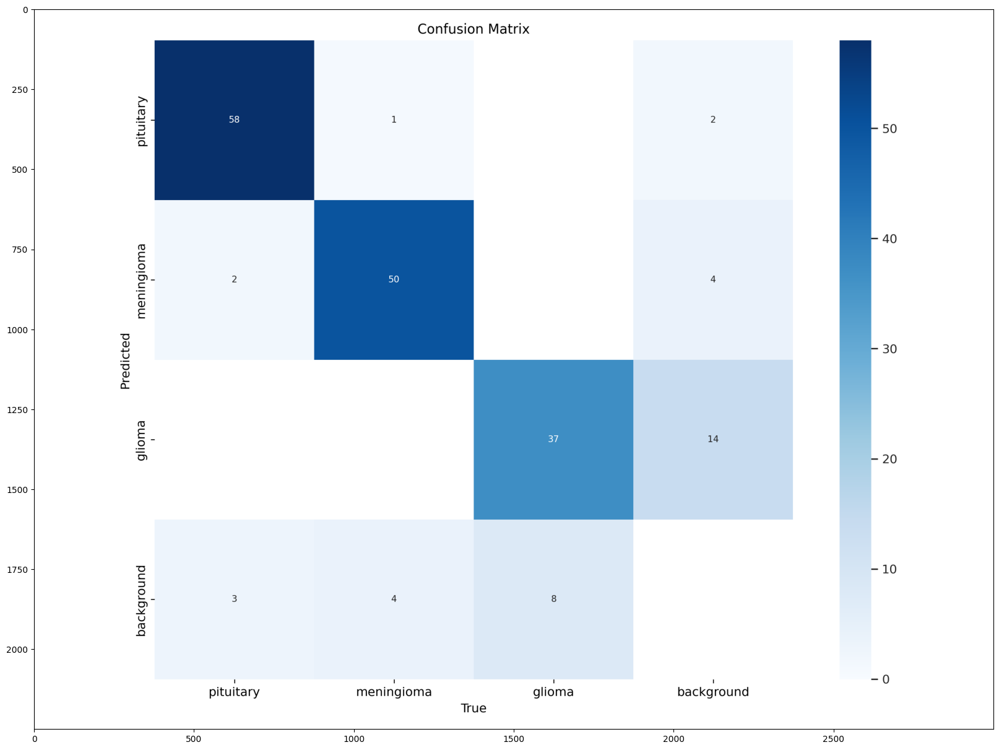

...

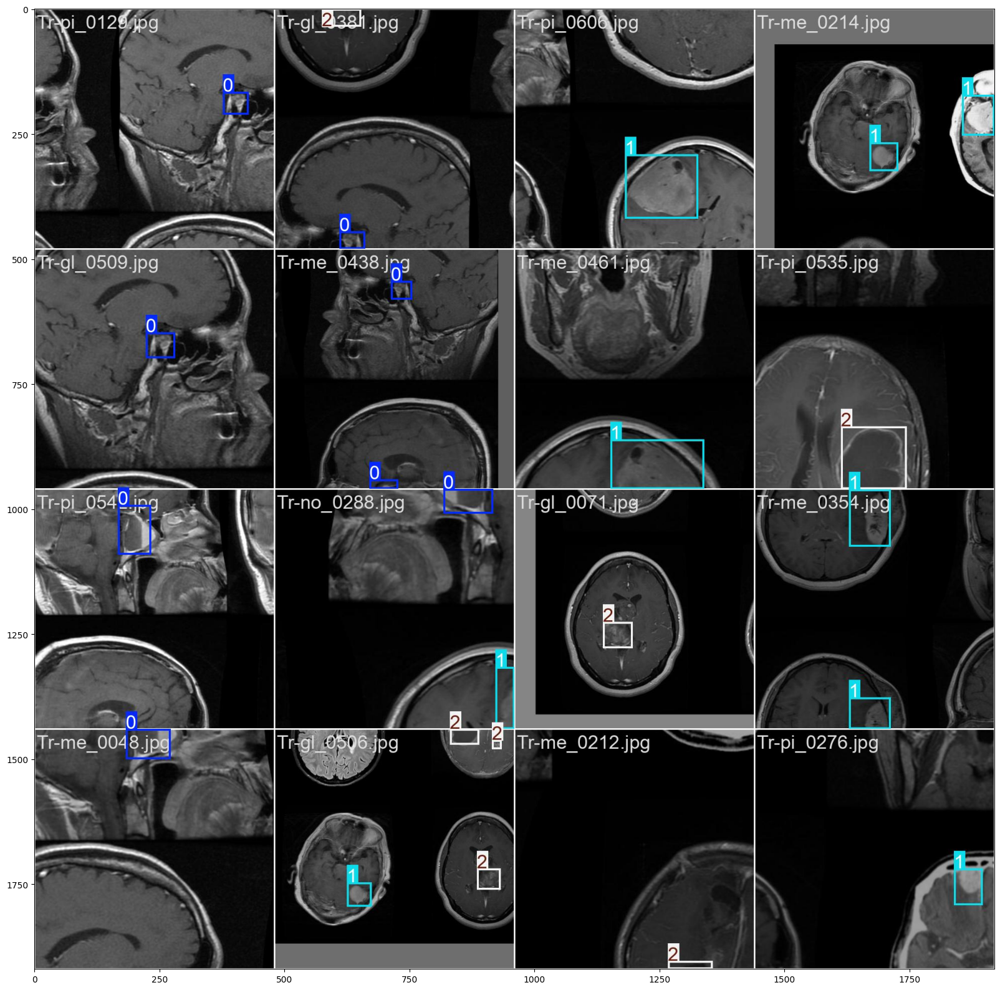

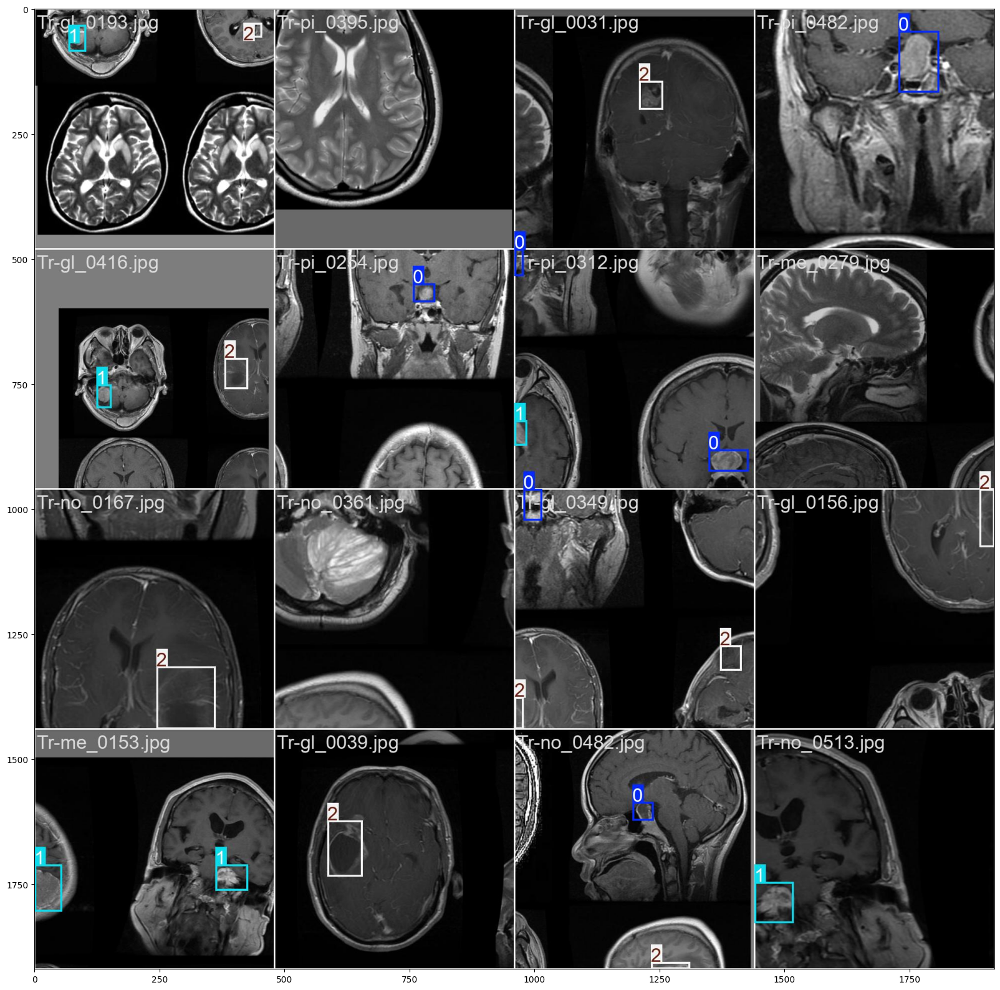

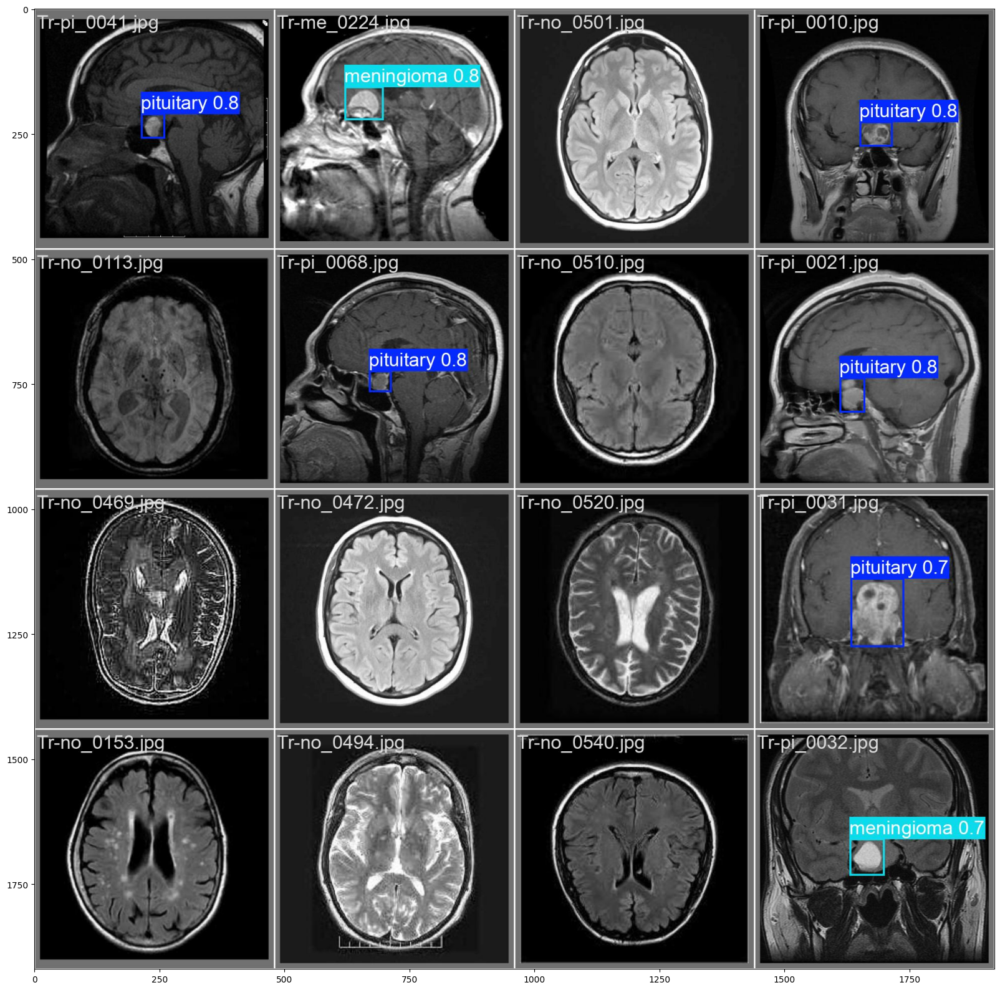

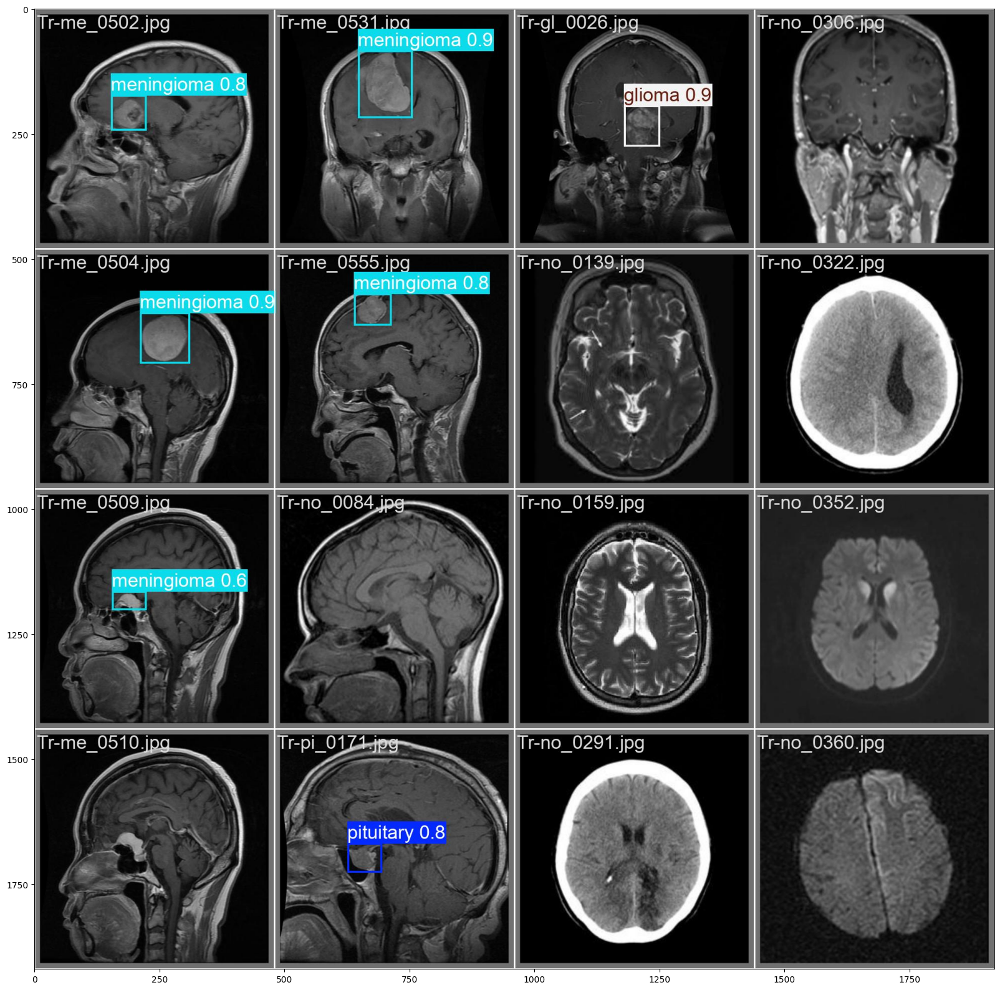

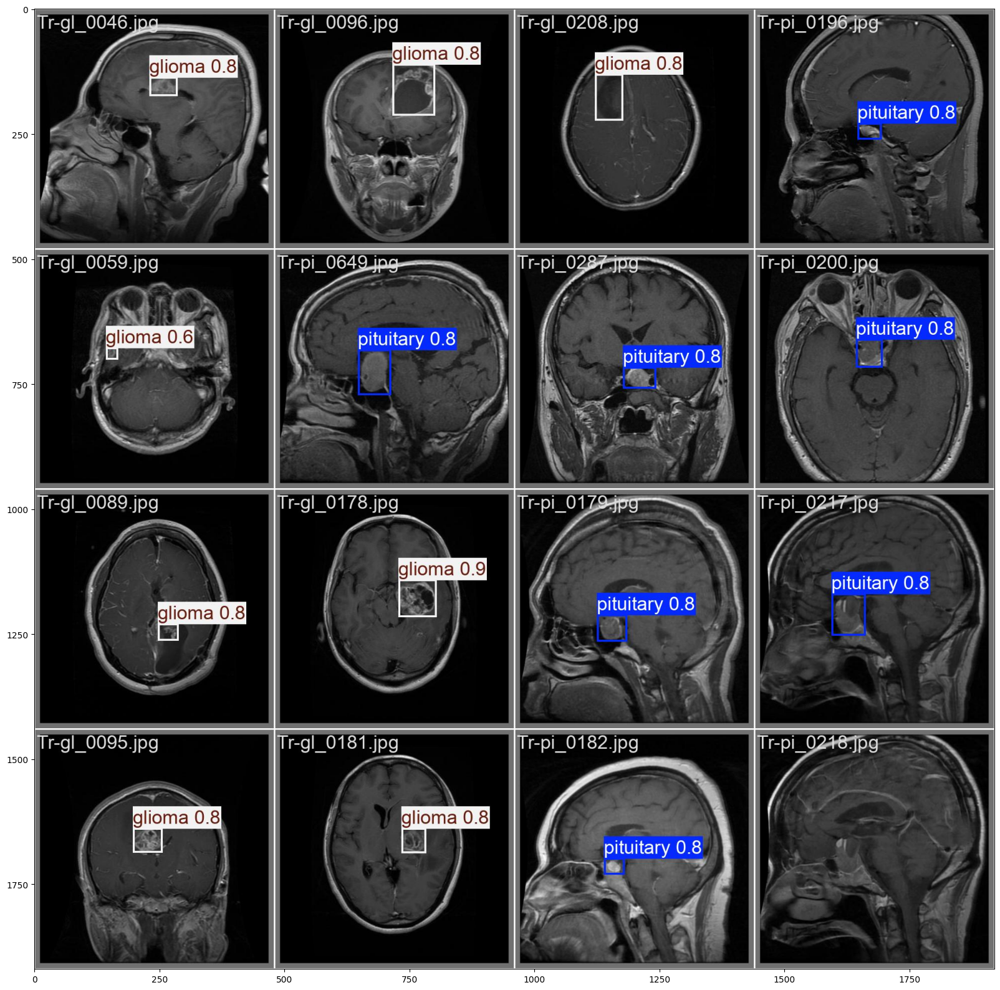

In [8]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

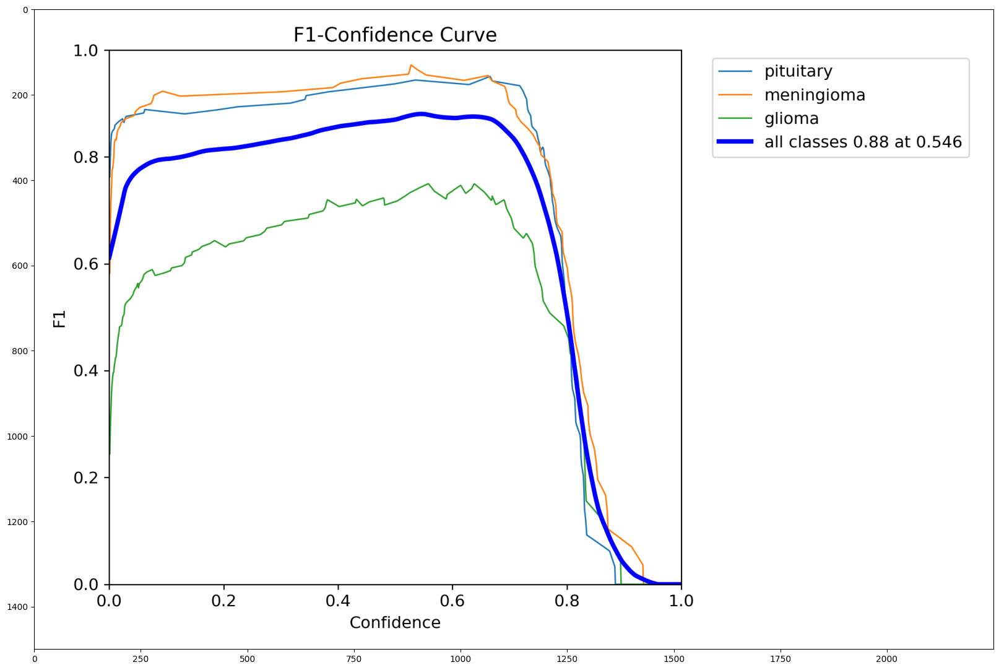

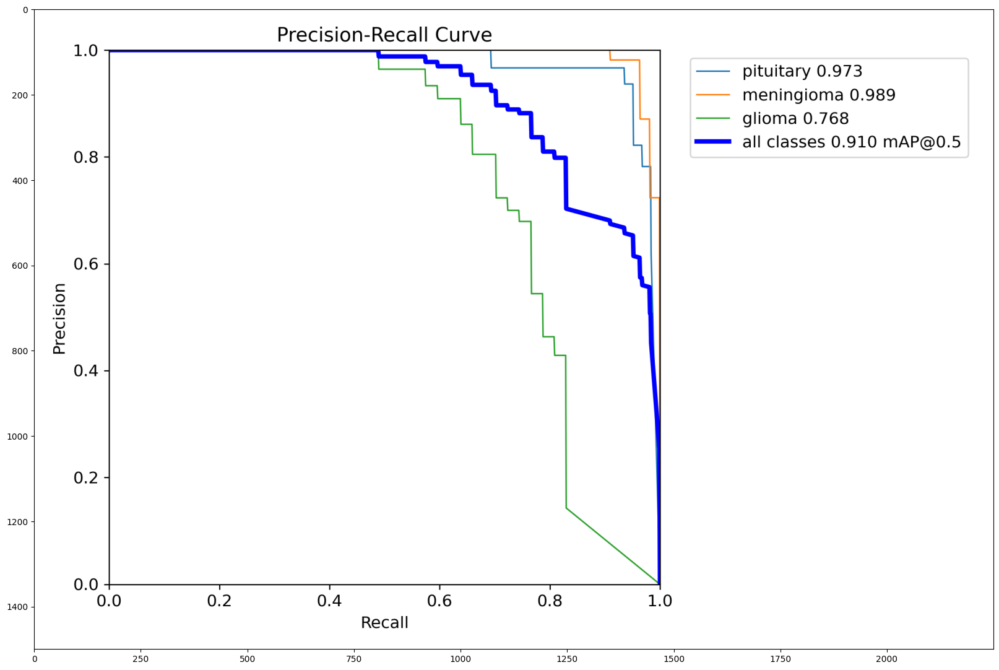

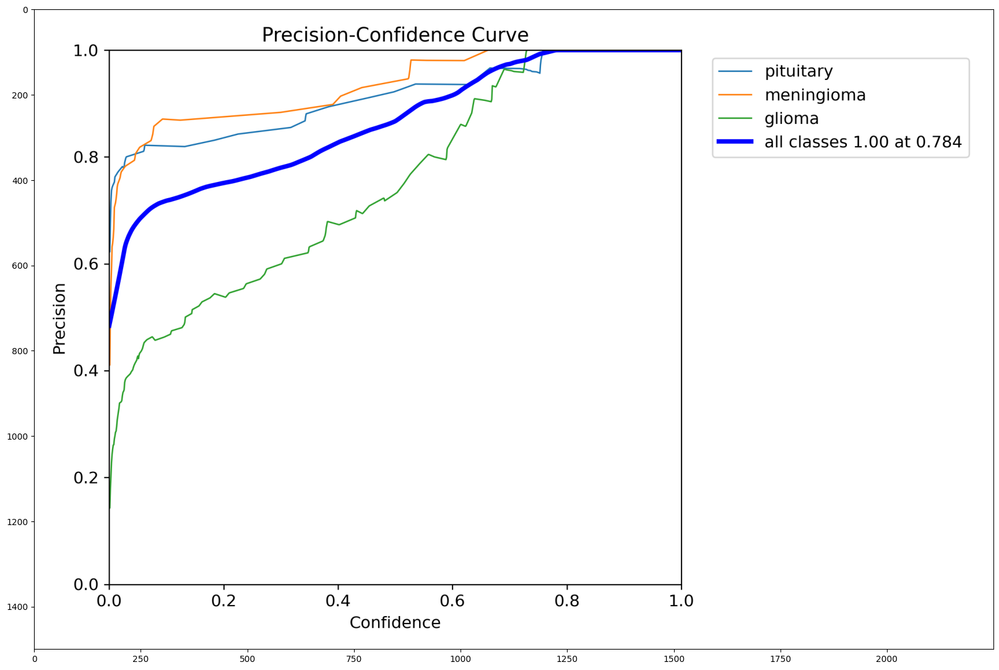

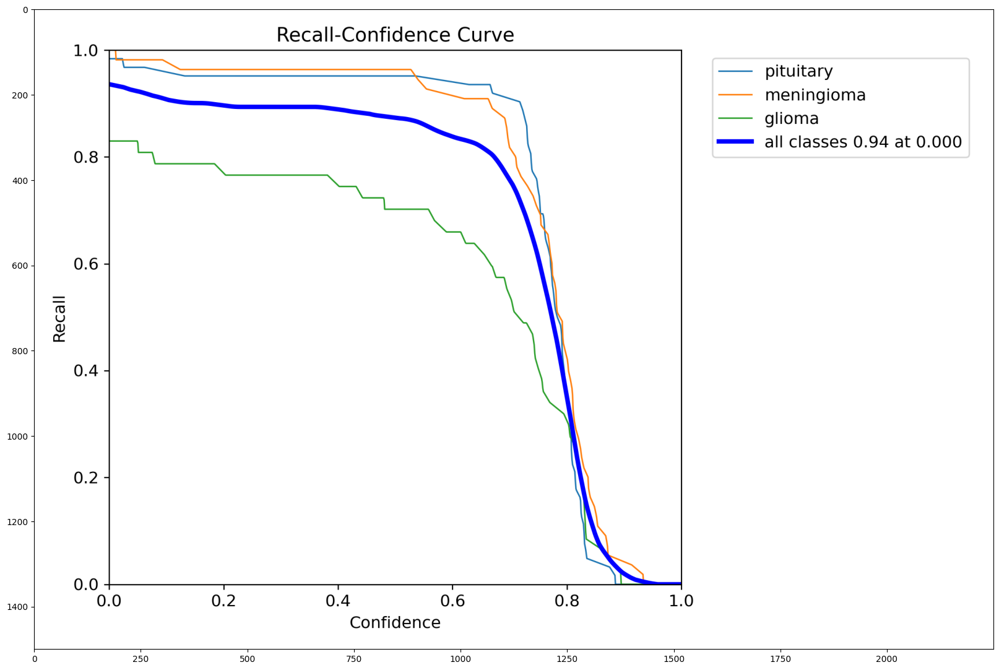

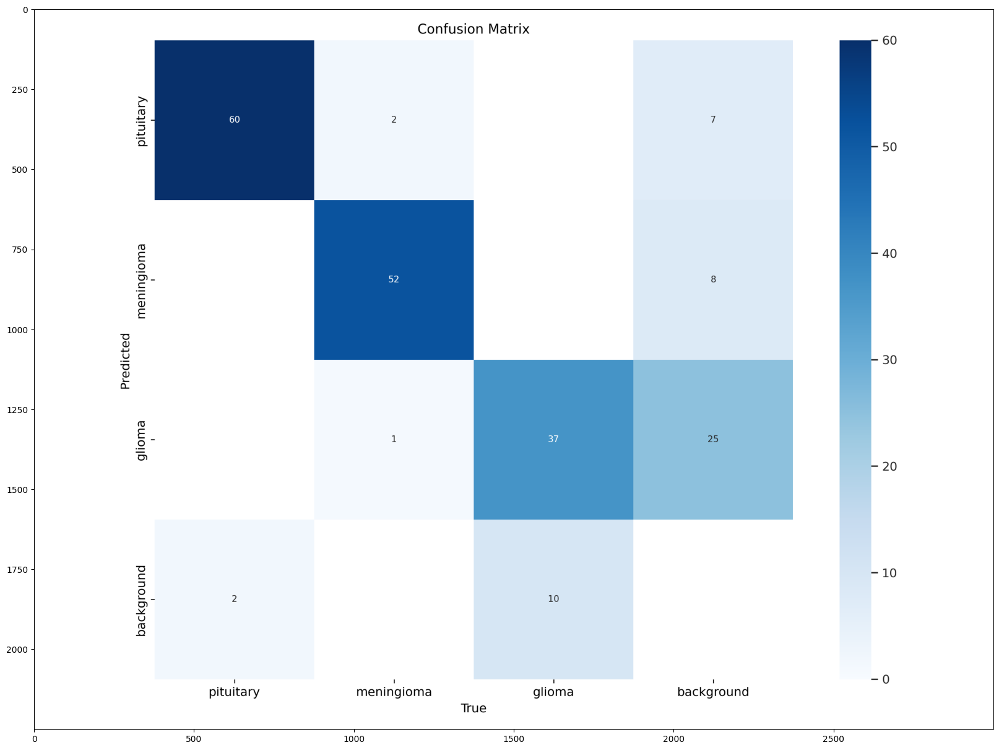

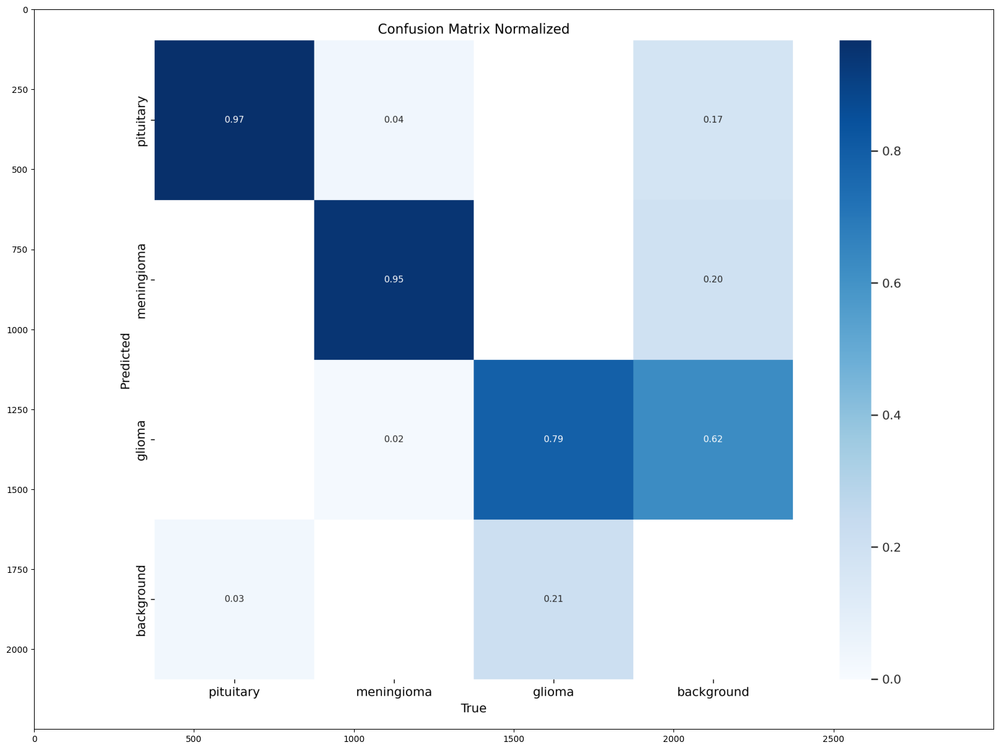

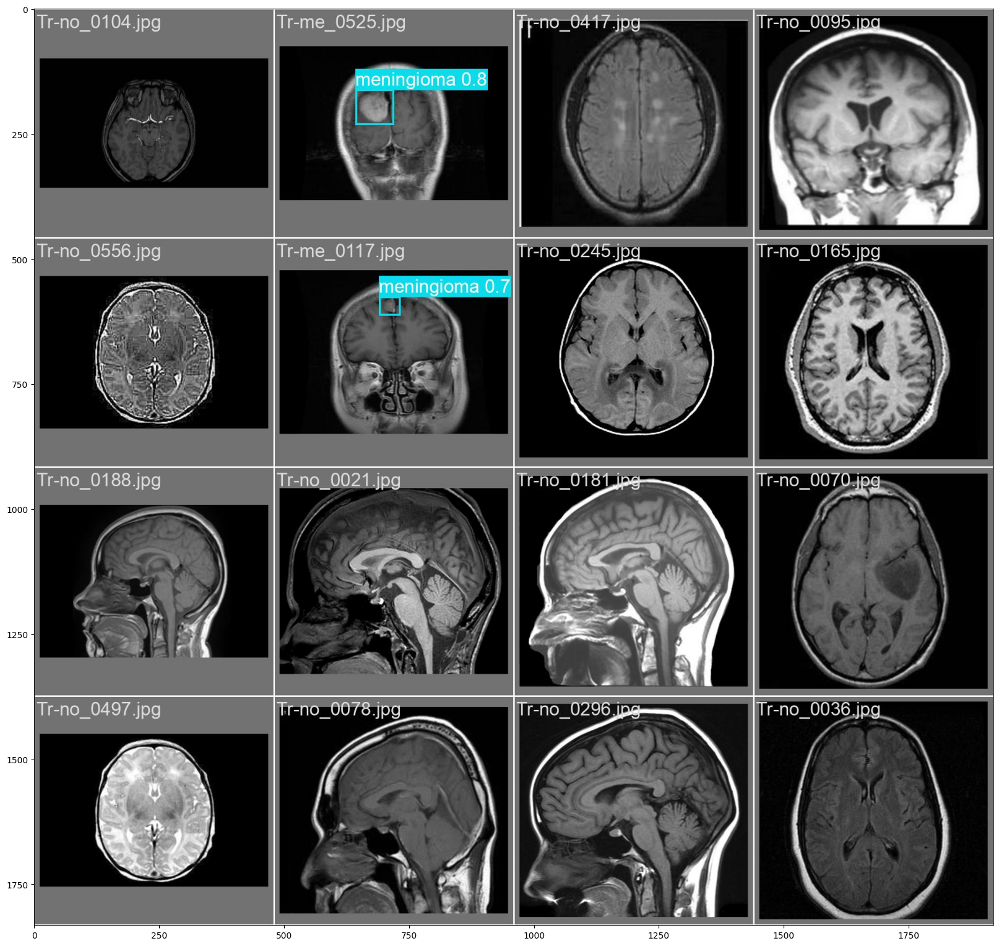

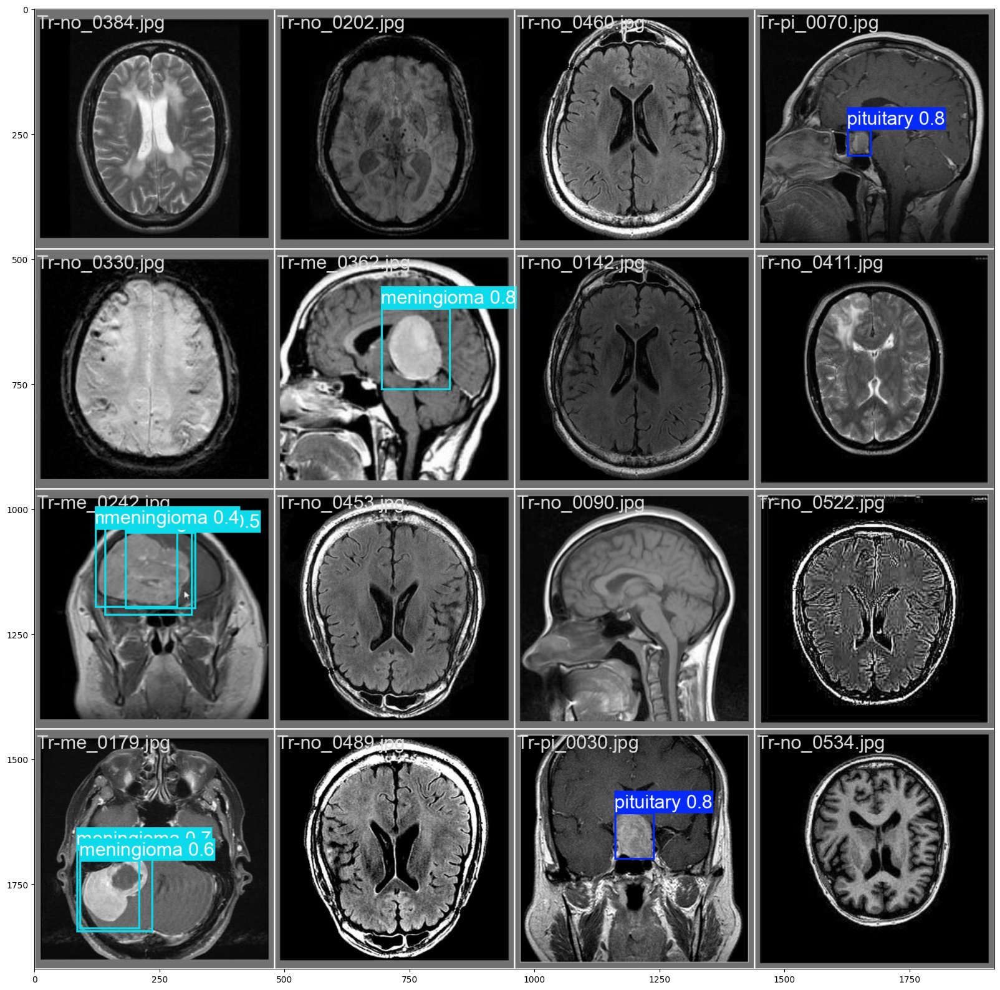

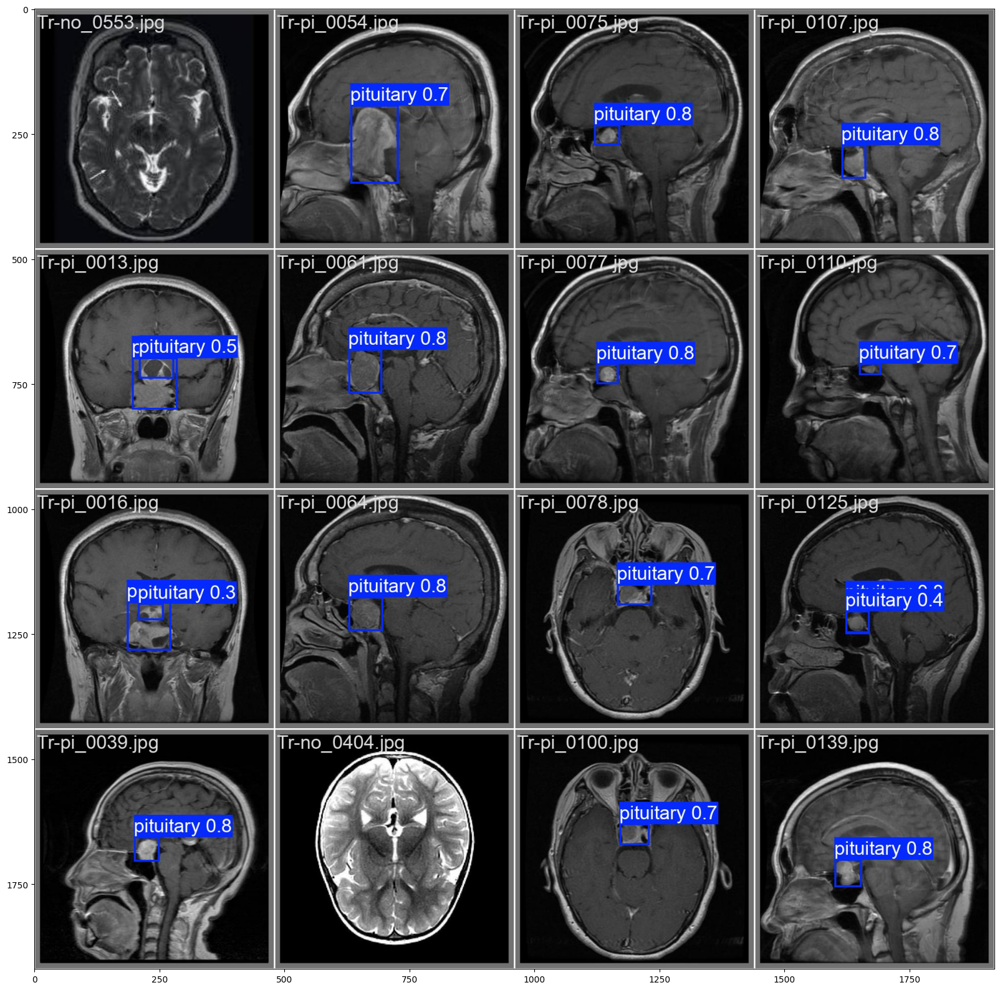

In [9]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()